# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

##### Dependencies

In [1]:
import pandas as pd
from sklearn.model_selection import KFold, LeaveOneOut, train_test_split, GridSearchCV, cross_val_score, cross_validate
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
import seaborn as sns
import random

from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.feature_selection import RFE, SequentialFeatureSelector
from sklearn.linear_model import Lasso, Ridge, LinearRegression, LassoCV
from sklearn.preprocessing import OneHotEncoder, StandardScaler, PolynomialFeatures, OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error
from sklearn.cluster import KMeans

import numpy as np
import re

In [24]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\UCBerkleyML-AI-TryIts\module 11\practical_application_II_starter\data\vehicles.csv')

##### Let's check missing values

In [7]:
df.isna().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

1. Remove Columns with Excessive Missing Data: For columns like **condition**, **cylinders**, **VIN**, **drive**, **size** and **paint_color** has high proportion of missing values. I decide to drop it. But say if I don't drop column, for sure I would 100% drop size and VIN. Though, I firm to drop all columns listed above.
2. Impute Missing Values for Important Variables: I am firm that columns like **year**, **manufacturer**, **model**, **fuel**, **odometer**, and **title_status** is essential for our analysis. Even though there are missing value but not quite that much proportionally to the total data points. I decide to impute. For numerical features, mean or median imputation. For categorical, I will use mode imputation.
3. Drop Rows with Missing Value of Target Feature: Since price is our target feature, I want to personally drop the rows that are missing value. But the last time I checked, fortunately, I don't have to drop anything due to non-missing value.
4. Evaluate each Feature's Importance: Prior to drop or impute any data, I want to understand the importance of each features in the context of predicting price of a car. Intuitively, as a car enthusiast, I would say that features like manufacturer, year, and odometer, are likely to be significant predictor of price and thus we give more sophisticated technique on handling data.
5. Handling Sparse or Less Important Features: I believe that features like region and state might introduce noise to the prediction of the model due to their high cardinality. I suggest to check its importance before include it into the model else I would just drop it.
6. Feature Engineering: On top of my head, I could use year features to create a new feature called age by taking the current date and minue the year of the use car. Maybe that's a factor that drive car price, for example, vintage car that is quite old with good mileage would appreciate in price.


### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

##### Cleaned Data

In [21]:
# let's do 1 and 2: imputing missing value and remove column
# impute numerical features
num_imputer = SimpleImputer(strategy='median')
df[['year', 'odometer']] = num_imputer.fit_transform(df[['year', 'odometer']])

# impute categorical features
cat_imputer = SimpleImputer(strategy='most_frequent')
df[['manufacturer', 'model', 'fuel', 'title_status', 'transmission']] = cat_imputer.fit_transform(df[['manufacturer', 'model', 'fuel', 'title_status', 'transmission', 'type']])

# column to drop
columns_to_drop = ['condition', 'cylinders', 'VIN', 'drive', 'size', 'paint_color']
df = df.drop(columns=columns_to_drop)

df.to_csv(r'C:\Users\Duy Nguyen\Downloads\UCBerkleyML-AI-TryIts\module 11\practical_application_II_starter\data\vehicles_cleaned_version_1.csv', index=False)
print("Data cleaning completed and saved as 'vehicles_cleaned.csv'.")

Data cleaning completed and saved as 'vehicles_cleaned.csv'.


In [68]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\UCBerkleyML-AI-TryIts\module 11\practical_application_II_starter\data\vehicles_cleaned_version_1.csv')

In [5]:
# let's check if there is still missing value
df.isna().sum()

id              0
region          0
price           0
year            0
manufacturer    0
model           0
fuel            0
odometer        0
title_status    0
transmission    0
type            0
state           0
dtype: int64

It is looking good that we have no missing data. However...

In [31]:
df.price.value_counts()

price
0        32895
6995      3169
7995      3129
9995      2867
8995      2837
         ...  
21298        1
49217        1
63195        1
19709        1
17873        1
Name: count, Length: 15655, dtype: int64

I just realized that there are quite a bit of data on price that car cost 0 dollars which makes no sense. Therefore I decide to drop the rows with car that price 0 dollars.

In [32]:
# Assuming you have already loaded the dataset into a DataFrame named 'df'

# Drop rows where the price is 0
df = df[df['price'] > 0]

# Save the filtered dataframe to a new CSV if you need to use it later
df.to_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\vehicles_cleaned_version_2.csv', index=False)

# Print the number of rows after filtering
print(f'Number of rows after removing $0 price listings: {df.shape[0]}')


Number of rows after removing $0 price listings: 393985


In [17]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\vehicles_cleaned_version_2.csv')
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 393985 entries, 0 to 393984
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            393985 non-null  int64  
 1   region        393985 non-null  object 
 2   price         393985 non-null  int64  
 3   year          393985 non-null  float64
 4   manufacturer  393985 non-null  object 
 5   model         393985 non-null  object 
 6   fuel          393985 non-null  object 
 7   odometer      393985 non-null  float64
 8   title_status  393985 non-null  object 
 9   transmission  393985 non-null  object 
 10  type          393985 non-null  object 
 11  state         393985 non-null  object 
dtypes: float64(2), int64(2), object(8)
memory usage: 36.1+ MB


Before we could able to find the features importance for price, we need to find the best fit model for the existing data first.

Since there are still quite couple categoricals feature. Let's tackle it one by one:
1. region
2. state

Since these two feature is cardianlity features, I will use frequency encoding because I want to map the frequency of each unique region and state

In [109]:
df.price.value_counts()

price
6995     3169
7995     3129
9995     2867
8995     2837
4500     2778
         ... 
47105       1
62987       1
40305       1
44691       1
17873       1
Name: count, Length: 15654, dtype: int64

### EDA

In [110]:
print(df[['price', 'year', 'odometer']].describe())

              price           year      odometer
count  3.939850e+05  393985.000000  3.939850e+05
mean   8.147763e+04    2011.012051  9.865289e+04
std    1.268064e+07       9.617171  2.053189e+05
min    1.000000e+00    1900.000000  0.000000e+00
25%    7.000000e+03    2008.000000  3.825300e+04
50%    1.500000e+04    2013.000000  8.640800e+04
75%    2.759000e+04    2017.000000  1.350000e+05
max    3.736929e+09    2022.000000  1.000000e+07


There are cars that worth 3.7 billison dollars. If we just raw plot the distribtuion, it will be very skews. Also that makes no sense as well.

Let's drop these impossible outliers as well. How would I drop it?

1. Consider super car is around 300k (Porches, Ferrari, or maye Lexus LFA, Aston Martin...). But again, those are very low counts in the manufacture distribution. Though I done some research and the most expensive car is Rolls-Royce Boat Tail. 

2. For odometer, most car are very beat up around 300,000 mileage so let only take the car below 300,000

The filter only take off around 2000 cars out of 400k ish data point is reasonable

#### Filter Data

In [20]:
# Initial filtering based on unrealistic maximum values observed in 'price' and 'odometer'
reasonable_max_price = 200000
reasonable_max_odometer = 300000  

# Filter the dataframe
df_filtered = df[
    (df['price'] <= reasonable_max_price) &
    (df['odometer'] <= reasonable_max_odometer)
]
df_filtered.to_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\vehicles_cleaned_version_3.csv', index=False)


##### Let's visualize the distribution of numerical values

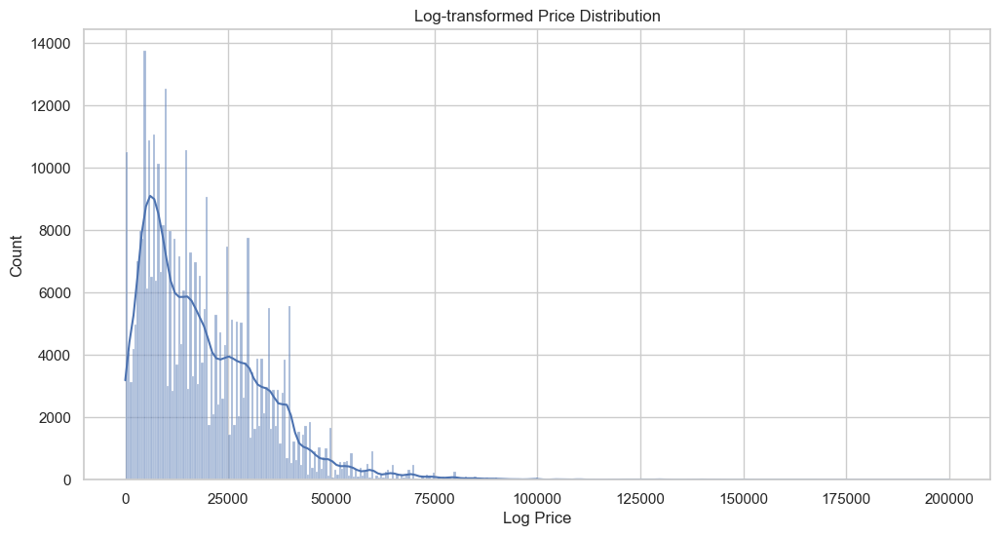

In [112]:

# Remove extreme outliers in 'price'
# Assuming we consider cars priced above $200,000 as outliers for this example
upper_limit = 200000
df_filtered_price = df[df['price'] <= upper_limit].copy()

# Visualize the new distribution of 'log_price'
plt.figure(figsize=(12, 6))
sns.histplot(df_filtered_price['price'], kde=True)
plt.title('Log-transformed Price Distribution')
plt.xlabel('Log Price')
plt.ylabel('Count')
plt.show()

price is heavily right skews as expected due to supercar in the market that worth up to 3.7 mils

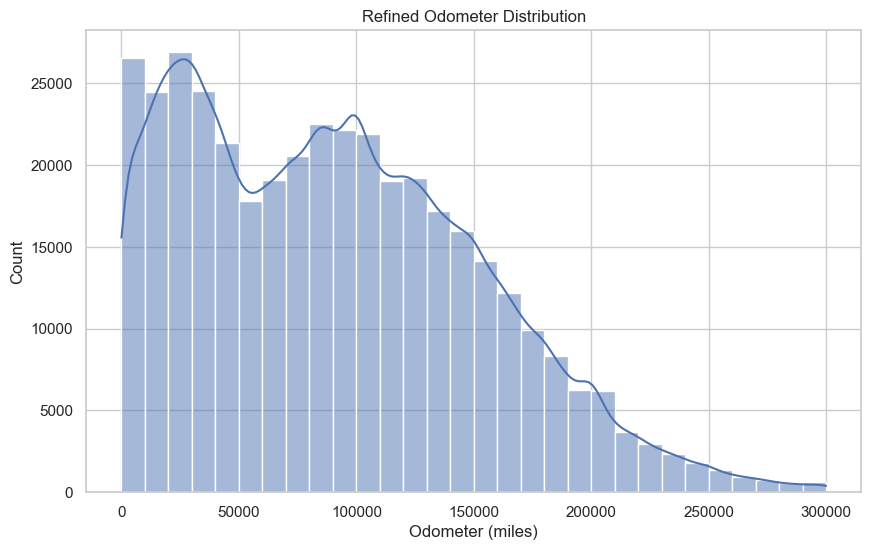

In [59]:

# Set a realistic upper limit for the odometer readings
upper_limit_odometer = 300000
df_filtered_odometer = df[df['odometer'] <= upper_limit_odometer].copy()

# Plotting the refined histogram for the odometer
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.histplot(df_filtered_odometer['odometer'], bins=30, kde=True)
plt.title('Refined Odometer Distribution')
plt.xlabel('Odometer (miles)')
plt.ylabel('Count')
plt.show()


There are two things I can see from this distribution:
1. Right Skewed
2. Most common range:
    - 10,000 to 150,000 miles where services happening the most frequently

Consideration that higher mileage implies more wear and tear. Also be consider that the dealership will have a cut off point when selecting car with high odometer for their inventory as well!

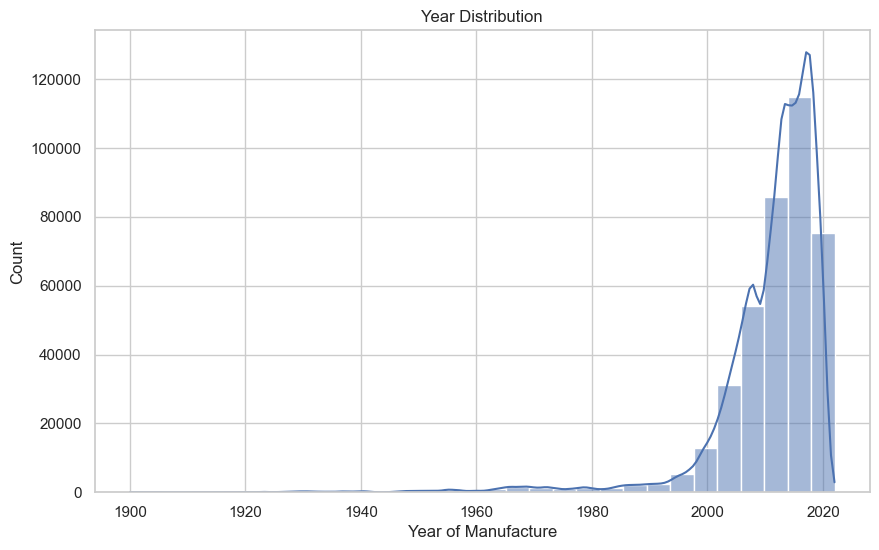

In [61]:

# Set the style for seaborn
sns.set(style="whitegrid")

# Plot the distribution of the 'year' column
plt.figure(figsize=(10, 6))
sns.histplot(df['year'], bins=30, kde=True)
plt.title('Year Distribution')
plt.xlabel('Year of Manufacture')
plt.ylabel('Count')
plt.show()


- manufacture a lot of cars in past two decades, this could mean that new cars are commonly resold.
- there is a decline of car before 1980 implication of fewer oldwer cars in the market, these car may yield higher price due to the collectible nature.
- for dealership, for the past 10 - 20 years are the sweet spot for inventory stocking. A lot in demand therefore manufacture.

As you can see that there are quite a bit of outlier, I would impute the missing data using median for nmerical values.

##### Let's visualize the distribution of categorical values

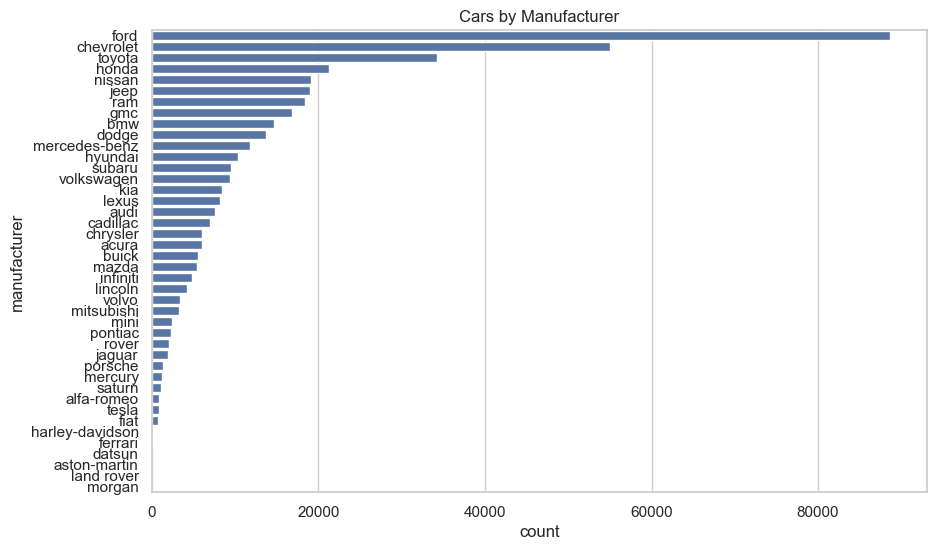

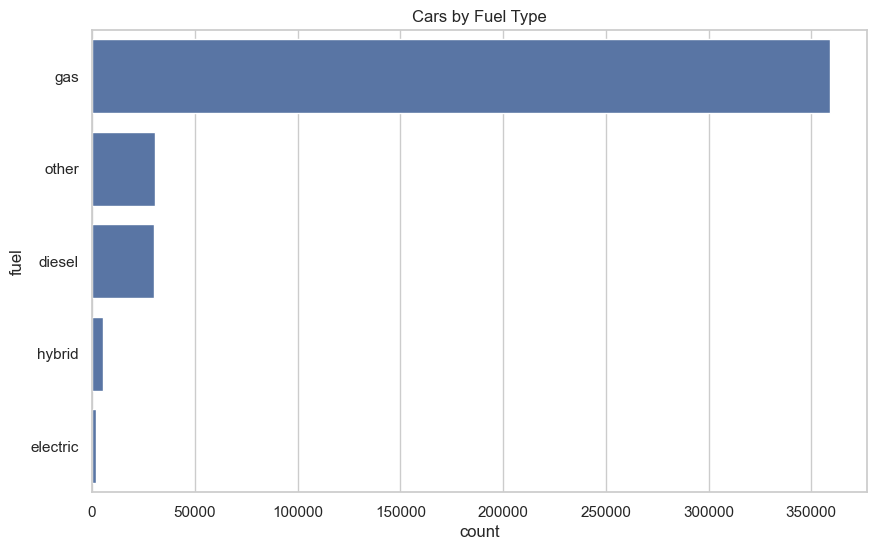

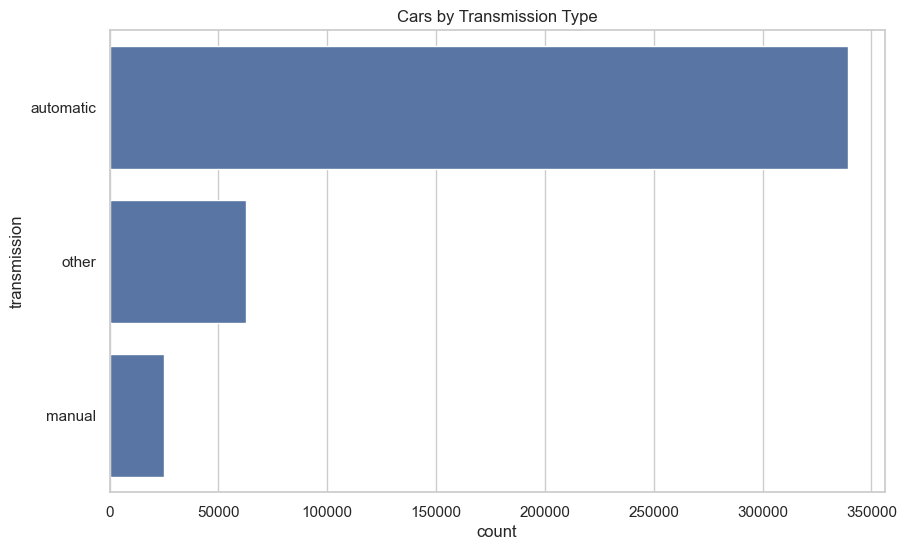

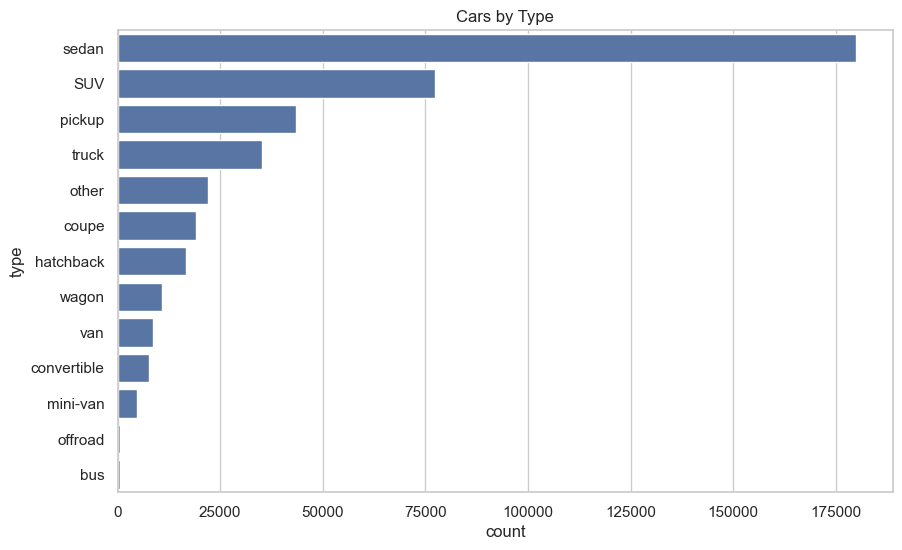

In [16]:
plt.figure(figsize=(10, 6))
sns.countplot(y='manufacturer', data=df, order = df['manufacturer'].value_counts().index)
plt.title('Cars by Manufacturer')
plt.show()

plt.figure(figsize=(10, 6))
sns.countplot(y='fuel', data=df)
plt.title('Cars by Fuel Type')
plt.show()

plt.figure(figsize=(10, 6))
sns.countplot(y='transmission', data=df)
plt.title('Cars by Transmission Type')
plt.show()

plt.figure(figsize=(10, 6))
sns.countplot(y='type', data=df, order = df['type'].value_counts().index)
plt.title('Cars by Type')
plt.show()


Graphs:
1. Ford, Chevelet, and Toyota are top three purchased car
2. Most the car purchased are gas
3. Most people drive automatic cars
4. Top three most purchase car type are Sedan, SUV, and pickup

##### Data Cleaning Recap
1. I dropped **condition**, **cylinders**, **VIN**, **drive**, **size** and **paint_color** features
2. I then impute categorical features: 'manufacturer', 'model', 'fuel', 'title_status', 'transmission', 'type'
3. I also imputed numerical features: 'year' and 'odometer'
4. I then found out that there are car worth either 0 or 3.7 billions dollars which makes no sense. Therefore I dropped car worth 0 dollars and capped the price at 300,000. There are only 2000 cars after 300,000 out of 390k number of cars. 
4. Same for odometers, some car can run for 10 millions mileage, which makes no sense especially cars these day, if lucky like Honda and Toyota can get up to 400,000 mileages. So I capped odometer at 300,

Now that we have the data ready for training, what are the strategies for modelling?

If you look at the type of the features, we have float64(2), int64(2), object(8) -> 8 categoricals data and 4 numericals

For region and state, it has a lot of unique values, we have 52 states, a lot of regions. If we decide to use one hot encoding, the results would be very sparse and high demensional dataset. Which is not good, computation intensive.

Though overall, I would save for simplicity, I will not include the region and state features.

In the modelling process, I want to fit every possible combination of the parameters of the model:

models:
1. LinearRegression()
2. Ridge()
3. Lasso()

feature engineering:
1. polynomial
2. one hot coding

feature selector:
1. RFE
2. SFS

cv strategies:
1. KFold
2. Leave One Out
3. Hold Out Split

For these parameters, we have hyperparameters:
1. Polynomial Degree : [1, 2, 3]
2. number of feature selector select: [5, 10, 15]
3. Lasso Alpha : [0.001, 0.01, 0.1, 1]
4. Ridge Alpha: [0.001, 0.01, 0.1, 1]

But to be realistic, trying out all these parameter with grid search, especially leave one out CV with 400k data point will take for ever. So I will make a strategies that would be best for this study.

### Modeling & Evaluation

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

In the first study, I treated it as an exploratory data analysis using modelling on sample data. In this study, I will performance a proper data dimensionality reduction using PCA, focusing on the most important features that influence inventory needs base on price.

But first let's further clean data, I suspect that the model has some naming error data entry

Considering that region feature introduce multicollinearity because region encompassed within a single state, making the information somewhat overlapping. For example, if the model predict a car cost 50k in SF Bay area in California, this information would be redundant. It is similar to predicting a box weight at  middle weight as 160lbs and 72kgs. Due to this reason and reason for its high cardinality. I decide to drop feature region in this study. 

In [3]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\final_vehicles.csv')

In [4]:
df = df.drop(['id',], axis=1)

the naming is long and redundant, let's just choose the first letter of the whole string as the model name

In [5]:
# Example: Splitting and taking the first part as the base model name
df['model_base'] = df['model'].str.split().str[0]

In [6]:
# Mark all duplicates in the 'model_base' column
duplicate_models = df[df.duplicated(subset=['model_base'], keep=False)]

# Extract the unique 'model_base' names that have duplicates
duplicate_model_names = duplicate_models['model_base'].unique()

# Print the duplicate model names
print("Duplicate model names:")
print(duplicate_model_names)

Duplicate model names:
['f-150' 'sierra' 'silverado' ... 'labaron' 'Toyoda' 'f150,']


there are naming inconsistancy like f-150 and f150, let's stardardize it

In [7]:
# Example: Standardizing 'f-150' and 'f150' to a single naming convention
df['model_base'] = df['model_base'].str.replace('-', '')
df['model_base'] = df['model_base'].str.lower()  # : also make everything lowercase for consistency

# You might want to review the unique values again to ensure the standardization worked as expected
print(df['model_base'].unique())


['f150' 'sierra' 'silverado' ... 'rx&' 'ati' 'gand']


In [8]:
duplicate_models = df[df.duplicated(subset=['model_base'], keep=False)][['manufacturer', 'model_base']]

# Print the duplicate models and their corresponding manufacturers
print("Duplicate models across different manufacturers:")
duplicate_model = pd.DataFrame(duplicate_models.sort_values(['model_base', 'manufacturer']))
duplicate_model

Duplicate models across different manufacturers:


,manufacturer,model_base
382043,bmw,
227157,chevrolet,
228601,chevrolet,
229288,chevrolet,
51488,ford,
...,...,...
199079,ford,♦all
199080,ford,♦all
128092,chrysler,♿
131348,chrysler,♿


there are duplicates in model, let's find it drop the duplicatate. However, I have notice that there are model that does not make sense to keep='First' like ♿ vmi and #NAME? also name that has no name

I will define a regular expression pattern to filter out valid model

In [9]:
pattern = r'^[a-zA-Z0-9\s]+$'  # Example pattern: alphanumeric characters and spaces

# Filter out rows where the 'model' column matches the pattern
df_1 = df[df['model_base'].str.match(pattern)]

let's also filter out model that begin with a number as well because it makes no sense

though I think a model can have a number, like bmw 4 mean the 4 series, pretty popular. However, I would say that there is an overlap that number could mean the year that model was release, so to be save, I would just drop model starting with number because of naming uncertainty, flag it as poor data collection!

In [12]:
pattern = r'^[^\d]+$'  # Exclude strings that consist only of digits

# Filter out rows where the 'model' column matches the pattern
filtered_df = df_1[df_1['model_base'].str.match(pattern)]

In [13]:
filtered_df.model.nunique()


18974

I investigate the csv file and found out that ford has misclassified model

In [15]:
ford = filtered_df[(filtered_df.manufacturer == 'ford') & (filtered_df.model_base == 'a')]
ford

,region,price,year,manufacturer,model,fuel,odometer,title_status,transmission,type,state,model_base
679,birmingham,29875,2013.0,ford,a Camry,gas,46947.0,clean,automatic,sedan,al,a
1653,birmingham,20900,2013.0,ford,a RAV4,gas,21324.0,clean,automatic,SUV,al,a
2859,huntsville / decatur,29875,2013.0,ford,a Camry,gas,46947.0,clean,automatic,sedan,al,a
3049,huntsville / decatur,23989,2013.0,ford,a RAV4,gas,34929.0,clean,automatic,SUV,al,a
3532,huntsville / decatur,23989,2013.0,ford,a RAV4,gas,34929.0,clean,automatic,SUV,al,a
7321,anchorage / mat-su,39995,2013.0,ford,a Tacoma,gas,16890.0,clean,automatic,pickup,ak,a
9044,mohave county,35987,2013.0,ford,a Highlander,gas,36553.0,clean,automatic,SUV,az,a
9160,mohave county,19987,2013.0,ford,a C-HR,gas,35806.0,clean,automatic,SUV,az,a
9411,mohave county,45987,2013.0,ford,a Tundra,gas,41053.0,clean,automatic,pickup,az,a
11773,phoenix,59995,2013.0,ford,a Tundra 4WD,gas,920.0,clean,automatic,pickup,az,a


these are all missed classified because all these model are toyota model. I will decide to dropped all of these because not that much data point will be dropped

In [16]:
filtered_df = filtered_df.drop(filtered_df[(filtered_df.manufacturer == 'ford') & (filtered_df.model_base == 'a')].index)

In [17]:
filtered_df.model_base.nunique()

2396

In [19]:
final_df = filtered_df.drop(['model'], axis=1)
final_df

,region,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
22,auburn,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra
23,auburn,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado
24,auburn,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado
25,auburn,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra
27,auburn,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra
...,...,...,...,...,...,...,...,...,...,...,...
391027,wyoming,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass
391028,wyoming,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc
391029,wyoming,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs
391030,wyoming,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima


Now let's check region features

In [20]:
region_df = final_df.copy()
region_df

region_df['region'] = region_df['region'].str.replace('-', '')
region_df['region'] = region_df['region'].str.lower()

In [21]:
pattern = r'^[a-zA-Z0-9\s]+$'

# Use the `~` operator to find rows NOT matching the pattern (i.e., containing 'weird' characters)
weird_rows = region_df[~region_df['region'].str.contains(pattern)]
weird_rows

,region,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
1993,florence / muscle shoals,21250,2002.0,ford,gas,15962.0,clean,automatic,convertible,al,thunderbird
1994,florence / muscle shoals,30990,2015.0,toyota,gas,34375.0,clean,other,pickup,al,tacoma
1995,florence / muscle shoals,16990,2016.0,kia,gas,17631.0,clean,other,coupe,al,forte
1996,florence / muscle shoals,16350,2013.0,ford,gas,83000.0,clean,automatic,van,al,econoline
1997,florence / muscle shoals,4100,2004.0,nissan,gas,226000.0,clean,automatic,SUV,al,armada
...,...,...,...,...,...,...,...,...,...,...,...
380625,duluth / superior,6000,2007.0,mini,gas,33000.0,clean,automatic,convertible,wi,cooper
380626,duluth / superior,1200,2006.0,saturn,gas,270000.0,clean,automatic,sedan,wi,vue
380627,duluth / superior,5400,2002.0,chevrolet,gas,175986.0,clean,automatic,sedan,wi,silverado
380628,duluth / superior,6995,2007.0,mercury,gas,126000.0,clean,automatic,sedan,wi,mountaineer


region that contain / make no sense because when I google it, it is two different city. For example, duluth  to superior  is 12 mins minenesota to wisconsin

so let's drop all the /

In [22]:
pattern = r'^[a-zA-Z0-9\s]+$'

# Select rows in 'region' that do not contain '/'
df_filtered = region_df[~region_df['region'].str.contains('/')]

weird_rows = df_filtered[~df_filtered['region'].str.contains(pattern)]
weird_rows


,region,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
79938,"washington, dc",17000,1988.0,alfa-romeo,gas,47800.0,clean,manual,sedan,dc,romeo
79940,"washington, dc",18895,2014.0,toyota,gas,77795.0,clean,automatic,mini-van,dc,sienna
79941,"washington, dc",8995,2011.0,kia,gas,104827.0,clean,automatic,SUV,dc,sorento
79942,"washington, dc",3000,1999.0,acura,gas,300000.0,clean,automatic,sedan,dc,tl
79943,"washington, dc",14995,2008.0,chevrolet,gas,131939.0,clean,automatic,truck,dc,silverado
...,...,...,...,...,...,...,...,...,...,...,...
379372,west virginia (old),15000,2006.0,ford,gas,15300.0,clean,automatic,sedan,wv,chysler
379373,west virginia (old),8700,2003.0,jeep,gas,145000.0,clean,manual,sedan,wv,wrangler
379374,west virginia (old),4100,2000.0,gmc,gas,200000.0,clean,automatic,truck,wv,sierra
379376,west virginia (old),16400,2014.0,lincoln,gas,41255.0,clean,automatic,sedan,wv,mkz


washington, dc where dc is already in state. This introduce further redundancy. Let's drop all the letter in region that already in state

In [24]:
def clean_region(row):
    # If the state is already present in the 'state' column, remove it from 'region'
    if row['state'] in row['region']:
        return row['region'].replace(", " + row['state'], "")
    else:
        return row['region']

# Apply the function to the DataFrame
df_filtered.loc[:, 'region'] = df_filtered.apply(clean_region, axis=1)

In [25]:
weird_rows = df_filtered[~df_filtered['region'].str.contains(pattern)]
weird_rows

,region,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
134700,"st louis, mo",1750,2002.0,honda,gas,237000.0,clean,automatic,sedan,il,accord
134701,"st louis, mo",69638,2020.0,chevrolet,diesel,34034.0,clean,automatic,pickup,il,silverado
134702,"st louis, mo",299,2012.0,gmc,gas,129682.0,clean,automatic,SUV,il,acadia
134703,"st louis, mo",3100,2004.0,chevrolet,gas,146903.0,clean,automatic,sedan,il,impala
134704,"st louis, mo",240,2008.0,chevrolet,gas,71244.0,clean,automatic,pickup,il,colorado
...,...,...,...,...,...,...,...,...,...,...,...
379372,west virginia (old),15000,2006.0,ford,gas,15300.0,clean,automatic,sedan,wv,chysler
379373,west virginia (old),8700,2003.0,jeep,gas,145000.0,clean,manual,sedan,wv,wrangler
379374,west virginia (old),4100,2000.0,gmc,gas,200000.0,clean,automatic,truck,wv,sierra
379376,west virginia (old),16400,2014.0,lincoln,gas,41255.0,clean,automatic,sedan,wv,mkz


at this point, there are too many wrong data entry, for example, st louis, mo is not in illinois, it is from Missouri

I make a decision with confirmation to drop it due to two reasons:
1. wrong data entry
2. overlapping state in region

In [80]:
df = final_df.drop(['region'], axis=1)

In [81]:
df

,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
22,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra
23,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado
24,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado
25,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra
27,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra
...,...,...,...,...,...,...,...,...,...,...
391027,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass
391028,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc
391029,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs
391030,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima


In [82]:
df.to_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\cleaned_vehicles.csv', index=False)

In [3]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\cleaned_vehicles.csv')
df

,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base
0,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra
1,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado
2,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado
3,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra
4,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra
...,...,...,...,...,...,...,...,...,...,...
291919,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass
291920,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc
291921,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs
291922,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima


now that the number of model name is in a reasonable range, we will have a reasonable memories to perform PCA. Before, 24000 unique model name give one hot would make the PCA to sparse

also, we got rid of region, our data is ready to train!

## Modelling

In [4]:

numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object', 'bool']).columns

# a transformer for categorical columns
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

# Combine transformers into a ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_cols),
        ('onehot', categorical_transformer, categorical_cols)
    ]
)



In [ ]:
# Apply transformations
df_transformed = preprocessor.fit_transform(df)

pca = PCA()
pca_transformed_data = pca.fit_transform(df_transformed.toarray())

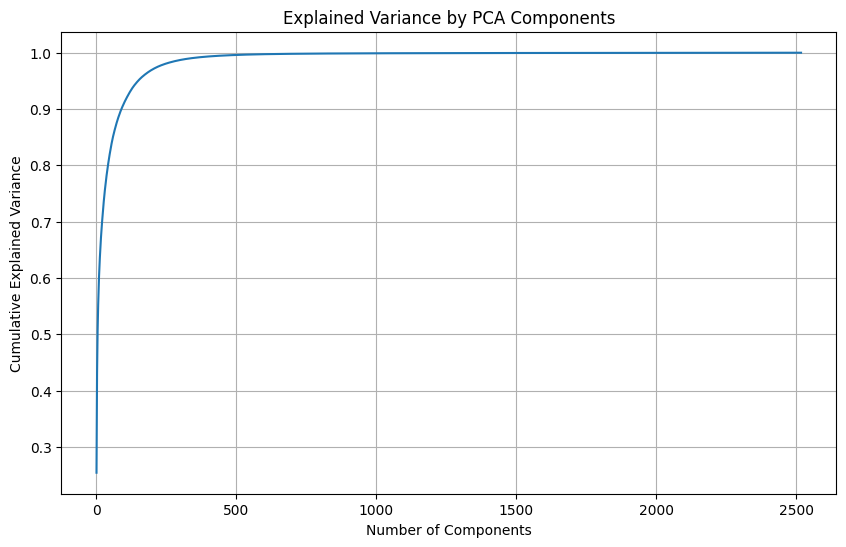

array([0.25412306, 0.35890538, 0.43112984, ..., 1.        , 1.        ,
       1.        ])

In [31]:

# let's visualized the explained variance by PCA components to k numbers of components
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), np.cumsum(pca.explained_variance_ratio_))
plt.title('Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)
cumulative_explained_variance

around 150 n_component is optimal

In [5]:
df_transformed = preprocessor.fit_transform(df)

pca = PCA(n_components=150, random_state=42)
components = pca.fit_transform(df_transformed.toarray())

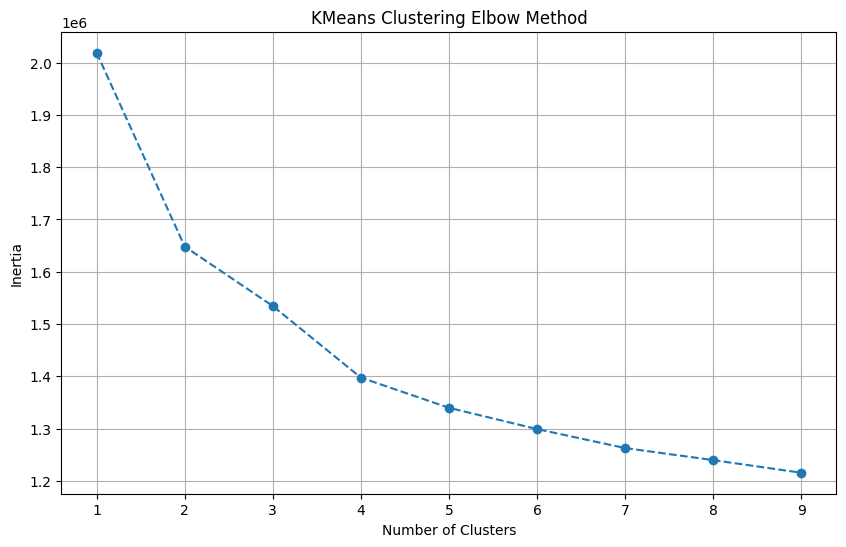

In [33]:
inertia = []
range_value = range(1, 10)
for i in range(1, 10):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(components[:, :150]) # again, we are using the first 10 components of our PCA
    inertia.append(kmeans.inertia_)

# let's viz the elbows
plt.figure(figsize=(10, 6))
plt.plot(range_value, inertia, marker='o', linestyle='--')
plt.title('KMeans Clustering Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.grid(True)
plt.show()

after four, the number of cluster inertia start to flat out. So four appear to be the optimal clusters

In [6]:
# now that we have the components, find the kmeans
optimal_cluster = 4
kmeans = KMeans(n_clusters=optimal_cluster, random_state=42).fit(components)
df['customer_cluster'] = kmeans.labels_

In [20]:
df

,index,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base,customer_cluster
0,0,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra,3
1,1,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado,3
2,2,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado,3
3,3,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra,3
4,4,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra,3
...,...,...,...,...,...,...,...,...,...,...,...,...
291919,291919,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass,3
291920,291920,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc,3
291921,291921,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs,3
291922,291922,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima,3


In [7]:
df = df.reset_index()
df

,index,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base,customer_cluster
0,0,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra,3
1,1,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado,3
2,2,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado,3
3,3,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra,3
4,4,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra,3
...,...,...,...,...,...,...,...,...,...,...,...,...
291919,291919,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass,3
291920,291920,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc,3
291921,291921,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs,3
291922,291922,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima,3


becareful, the data is still presence of categorical value, if you want to find the aggregate mean of each feature, you need to one hot encoding the categorical features still

In [67]:
categorical_cols = df.select_dtypes(include=['object', 'bool']).columns

# Example for one-hot encoding with pandas
df = pd.get_dummies(df, columns=categorical_cols)


In [ ]:
cluster_centroids = df.groupby('customer_cluster').mean()


save this dataframe for easier interpretation analysis

In [38]:
cluster_centroids.to_csv('C:/Users/Duy Nguyen/Downloads/practical_application_II_starter/data/pca_data/cluster_centroids.csv')

In [69]:
cluster_centroids

,index,price,year,odometer,manufacturer_acura,manufacturer_alfa-romeo,manufacturer_aston-martin,manufacturer_audi,manufacturer_bmw,manufacturer_buick,...,model_base_yukonslt,model_base_yulon,model_base_yundai,model_base_z,model_base_zap,model_base_zdm,model_base_zdx,model_base_zenith,model_base_zephyr,model_base_zj
customer_cluster,,,,,,,,,,,,,,,,,,,,,
0,191998.896840,17536.136544,1969.120536,55665.054180,0.000274,0.003420,0.000000,0.000000,0.000274,0.022301,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000274,0.000000
1,198009.326135,7436.484033,2006.822488,161448.234054,0.014719,0.000022,0.000000,0.001044,0.000075,0.016731,...,0.000000,0.000011,0.000011,0.000000,0.000000,0.000011,0.000022,0.000000,0.000151,0.000011
2,193039.454049,13757.933228,2013.517498,75131.311179,0.014670,0.000310,0.000035,0.000957,0.000151,0.016443,...,0.000009,0.000000,0.000000,0.000027,0.000009,0.000000,0.000000,0.000009,0.000027,0.000000
3,194816.969934,34758.301881,2017.029394,34844.582394,0.033059,0.009954,0.000216,0.001737,0.000114,0.019376,...,0.000000,0.000000,0.000000,0.000038,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


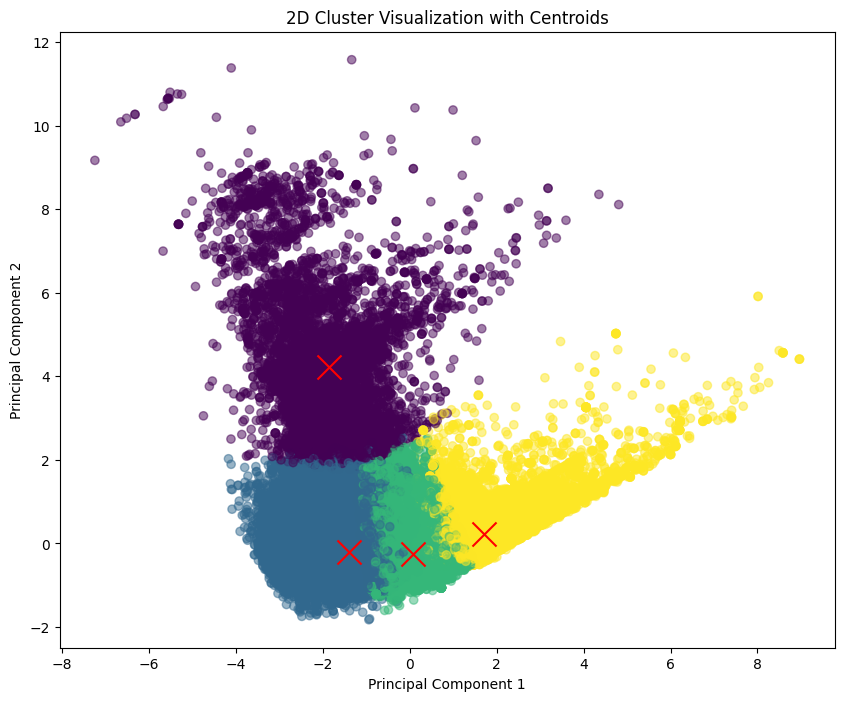

In [58]:

plt.figure(figsize=(10, 8))
plt.scatter(components[:, 0], components[:, 1], c=kmeans.labels_, cmap='viridis', marker='o', alpha=0.5)

# Plotting centroids
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=300, marker='x')  # s is the size of the centroid markers

plt.title('2D Cluster Visualization with Centroids')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

##### 3D Viz of PCA

In [60]:
import plotly.graph_objs as go

centroids = kmeans.cluster_centers_

# Create a trace for the data points
trace1 = go.Scatter3d(
    x=components[:, 0],
    y=components[:, 1],
    z=components[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color=kmeans.labels_,                # set color to the cluster labels
        colorscale='Viridis',                # choose a colorscale
        opacity=0.8
    )
)

# Create a trace for the centroids
trace2 = go.Scatter3d(
    x=centroids[:, 0],
    y=centroids[:, 1],
    z=centroids[:, 2],
    mode='markers',
    marker=dict(
        size=10,
        color=np.arange(len(centroids)),    # distinct color for each centroid
        colorscale='Viridis',
        symbol='x',
        line=dict(
            color='black',
            width=1
        )
    ),
    name='Centroids'
)

data = [trace1, trace2]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    ),
    scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3')
    )
)

fig = go.Figure(data=data, layout=layout)
fig.show()


#### Customer Segmentation Interpretation

1. Price Sensitivity and Car Age Preference:
    - Cluster 1 appears to be the most price-sensitive, with the lowest average price (~$7,436) and the oldest cars (average year ~2006) with the highest odometer readings (average ~161,448 miles).
    - Cluster 3 customers are likely less price-sensitive, preferring newer, more expensive cars (average year ~2017, average price ~$34,758) with lower odometer readings (average ~34,844 miles).
    - Clusters 0 and 2 represent middle grounds in terms of price, year, and odometer readings.

2. Manufacturer Preferences:
    - Ford and Chevrolet emerge as the most preferred manufacturers across all clusters, with Ford being particularly dominant in Cluster 0 and Chevrolet showing strong preferences in Clusters 0, 1, and 3.
    Preferences for manufacturers like Volkswagen, Pontiac, Dodge, and Cadillac vary significantly across clusters, indicating niche markets or specific uses associated with these brands.
    
    Cluster 0:
    - This cluster has a strong preference for Ford, followed by Chevrolet. It also shows considerable interest in Volkswagen, Pontiac, and Dodge.
    - The preference for Pontiac, a brand known for sports cars and performance vehicles that is no longer in production, suggests that Cluster 0 might value performance or have a penchant for classic American brands.

    Cluster 1:
    - Ford, Chevrolet, and GMC are popular, indicating a preference for traditional American manufacturers. This cluster's significant interest in GMC, higher than in other clusters, might reflect a focus on utility or premium American vehicles.
    - Dodge and Cadillac also appear in the preferences, suggesting a mix of performance and luxury interests within this cluster.

    Cluster 2:
    - Ford and Chevrolet remain popular, with Dodge and Mercedes-Benz also seeing higher preferences in this cluster. The interest in Mercedes-Benz, combined with the continued popularity of American brands, suggests a blend of practicality with a taste for luxury.
    - Volkswagen's presence indicates an openness to European manufacturers, known for engineering and fuel efficiency.

    Cluster 3:
    - Chevrolet, Mercedes-Benz, and GMC are notably preferred in this cluster, with Mercedes-Benz and GMC ranking higher than in other clusters. This signals a strong inclination towards luxury (Mercedes-Benz) and premium utility vehicles (GMC).
    - Ford sees less preference here compared to other clusters, suggesting that Cluster 3's interests might lean more towards luxury and premium segments.

3. Model Specificity:

    Cluster 0:
    - Corvette, Mustang, and Camaro stand out as the top preferred models in this cluster, indicating a strong interest in American sports cars and muscle cars. This cluster values performance, style, and perhaps the heritage associated with these iconic models.
    - Oldsmobile and Plymouth models, though less popular than the top three, suggest an interest in classic American cars or specific models from these brands that may no longer be in production.

    Cluster 1:
    - While there's a lower overall preference for specific models in this cluster, the Mustang appears as a notable exception. This indicates a niche interest in sports cars amidst potentially more practical or economical choices.
    - The significantly lower preference levels for specific models might imply that this cluster's priorities could be driven by factors other than the model, such as price, fuel efficiency, or utility.

    Cluster 2:
    - Similar to Cluster 0, Mustang and Camaro are preferred, albeit at lower levels, suggesting a shared interest in performance cars but with possibly broader vehicle needs or budget considerations.
    - The overall lower preference for specific models compared to Cluster 0 could indicate a more diverse range of interests within this cluster, with no single model dominating the preferences.

    Cluster 3:
    - Corvette and Mustang show the highest preferences in this cluster as well, underscoring an interest in luxury and performance. The higher preference for Corvette, in particular, could reflect a segment within this cluster that prioritizes premium performance vehicles.
    - The presence of Camaro as a preferred model, while less pronounced than Corvette or Mustang, adds to the evidence of a performance-oriented segment within this cluster.

4. Title Status:
- The majority of customers in all clusters prefer vehicles with a clean title status, with a mean preference above 96% across the board. This indicates a universal preference for vehicles without legal or operational issues.
- There's a small but noticeable interest in vehicles with rebuilt titles and salvage titles, indicating a segment of customers willing to consider vehicles that have been repaired or have some issues, likely for price reasons.

5. Fuel Type:
- Gasoline is the dominant fuel type preference across all clusters, with an average preference of over 88%. This suggests that, despite the variety of available fuel types, gasoline vehicles remain the preferred choice.
- There's a notable preference for other fuel types as well, including diesel and electric, although to a much lesser extent. The presence of electric vehicles, even if small, indicates an openness or shift towards alternative energy vehicles among some customers.

6. Transmission:
- Automatic transmissions are overwhelmingly preferred in all clusters, which reflects the broader market trend towards convenience and ease of use in driving.
- There is a smaller, yet significant interest in manual transmissions among some clusters, suggesting a niche market of enthusiasts or customers who prefer the control that manual transmission provides.

7. Vehicle Type:
- Sedans are the most preferred vehicle type, with a preference of around 43.5% on average across the clusters, indicating a strong market for traditional passenger cars.
- SUVs also show significant popularity, particularly in clusters with a higher preference for newer, more expensive cars. This aligns with global trends of increasing SUV sales.
- Pickup trucks and coupes also have a meaningful presence, suggesting diverse customer needs and interests ranging from utility to sportiness.

With these detailed insights from deep analysis, I would consult dealership to:
1. Luxury and Performance:
- Targeted at Clusters 0 and 3, stock inventory with a higher proportion of performance and luxury vehicles. This includes sports cars like the Corvette, Mustang, and Camaro, with an emphasis on newer models for Cluster 3 to cater to its preference for recent, low-mileage vehicles.
- For Cluster 3, also include premium brands like Mercedes-Benz, indicating their inclination towards luxury alongside performance.
2. Economy and Practicality Segment:
- For Cluster 1, prioritize more economical and practical vehicles. This cluster's preferences suggest a focus on affordability, higher mileage vehicles, and utility, which could be met with brands like Ford and Chevrolet but leaning towards their more budget-friendly and functional models.
- Include a selection of older models that offer value for money, catering to the cluster's willingness to consider vehicles with higher odometer readings.

3. Diversity with Dynamic Market:
- Cluster 2 shows a mix of preferences, indicating a group with diverse vehicle needs. Stock a balanced mix of vehicles, from economical to mid-range performance models. While still valuing brands like Ford and Chevrolet, there's also an openness to models from Volkswagen and a mix of sedans and SUVs.

Regarding cluster, focus on clean titles. Additionally, focus on automatic transmissions and gasoline fuel types, which are broadly preferred.

### Understanding Relationships and Predicting Outcomes

from the dimension reduction and clustering analysis above, I believe that the cluster feature capture the latent factors that affect the target variable but aren't directly observable in the original data. Therefore I consider cluster is a feature engineering part of the new dataset for modelling.

In [18]:
import pandas as pd
from sklearn.model_selection import KFold, LeaveOneOut, train_test_split, GridSearchCV, cross_val_score, cross_validate
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
import seaborn as sns
import random

from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.feature_selection import RFE, SequentialFeatureSelector
from sklearn.linear_model import Lasso, Ridge, LinearRegression, LassoCV, RidgeCV
from sklearn.preprocessing import OneHotEncoder, StandardScaler, PolynomialFeatures, OrdinalEncoder
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.metrics import mean_squared_error, make_scorer, root_mean_squared_error, mean_absolute_error, r2_score
from sklearn.cluster import KMeans

import numpy as np
import re

In [3]:
df = pd.read_csv(r'C:\Users\Duy Nguyen\Downloads\practical_application_II_starter\data\pca_data\cleaned_vehicles_cluster.csv')

In [4]:
df

,index,price,year,manufacturer,fuel,odometer,title_status,transmission,type,state,model_base,customer_cluster
0,0,33590,2014.0,gmc,gas,57923.0,clean,other,pickup,al,sierra,3
1,1,22590,2010.0,chevrolet,gas,71229.0,clean,other,pickup,al,silverado,3
2,2,39590,2020.0,chevrolet,gas,19160.0,clean,other,pickup,al,silverado,3
3,3,30990,2017.0,toyota,gas,41124.0,clean,other,pickup,al,tundra,3
4,4,27990,2012.0,gmc,gas,68696.0,clean,other,pickup,al,sierra,3
...,...,...,...,...,...,...,...,...,...,...,...,...
291919,291919,32590,2020.0,mercedes-benz,gas,19059.0,clean,other,sedan,wy,cclass,3
291920,291920,30990,2018.0,mercedes-benz,gas,15080.0,clean,automatic,other,wy,glc,3
291921,291921,33590,2018.0,lexus,gas,30814.0,clean,automatic,sedan,wy,gs,3
291922,291922,23590,2019.0,nissan,gas,32226.0,clean,other,sedan,wy,maxima,3


In [5]:
X = df.drop(['price', 'index'], axis=1)
y = df.price

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Modelling

Let's have a baseline model, Linear Regression

In [4]:
numerical_cols = X_train.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = X_train.select_dtypes(include=['object', 'bool']).columns

# Define the preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_cols),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)
    ])

# Create the pipeline
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', LinearRegression())
])

Training

In [5]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  Index(['year', 'odometer'], dtype='object')),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['manufacturer', 'fuel', 'title_status', 'transmission', 'type', 'state',
       'model_base'],
      dtype='object'))])),
                ('model', LinearRegression())])

Evaluation

In [6]:
y_pred = pipeline.predict(X_test)

# Calculate the Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
rmse = root_mean_squared_error(y_test, y_pred)
print(f"Root Mean Squared Error: {mse}")
print(f"Mean Squared Error: {rmse}")

Root Mean Squared Error: 70831982.23963118
Mean Squared Error: 8416.173847992399


In [7]:
model_coefs = pipeline.named_steps['model'].coef_
features = pipeline.named_steps['preprocessor'].transformers_[1][1].get_feature_names_out(categorical_cols)
# Combine feature names and coefficients
coefs_with_features = pd.DataFrame(zip(features, model_coefs), columns=['Feature', 'Coefficient']).sort_values(by='Coefficient', key=abs, ascending=False)
print(coefs_with_features)


                      Feature    Coefficient
1108        model_base_invita  163916.968324
1673       model_base_ricardo  117486.060985
1337  model_base_mercecesbenz  111053.036123
1322           model_base_mdx  109971.406897
1195        model_base_lancer   98758.996106
...                       ...            ...
81                   state_id      35.740303
1842        model_base_solara      24.486539
262         model_base_bettle       7.735010
1107      model_base_intrepid       2.388442
80                   state_ia      -2.078142

[2295 rows x 2 columns]


## Non-Linear Relationship Features wrt Price

I suspect that some features are non-linear to the target variable. The wide range of coefficient magnitudes, especially the very high values for certain car models, can hint at non-linear relationships

Let's use scatter plot to clarify!

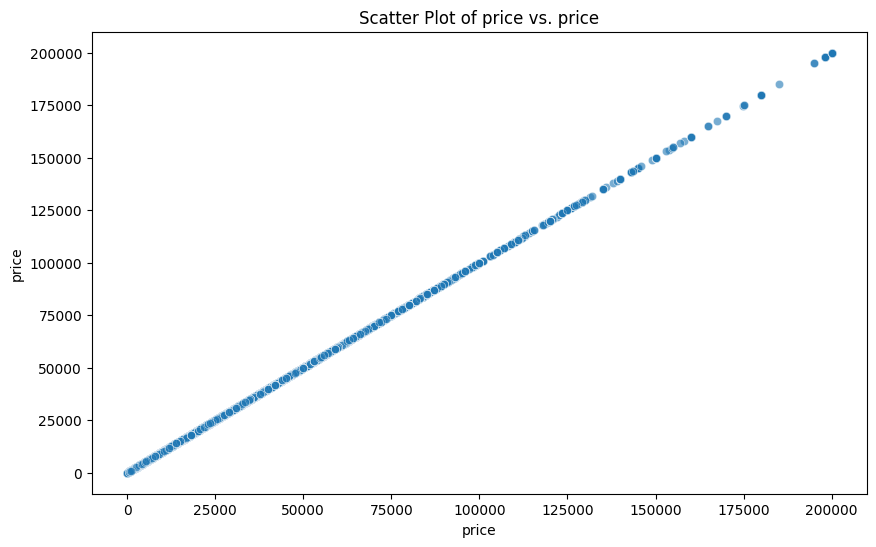

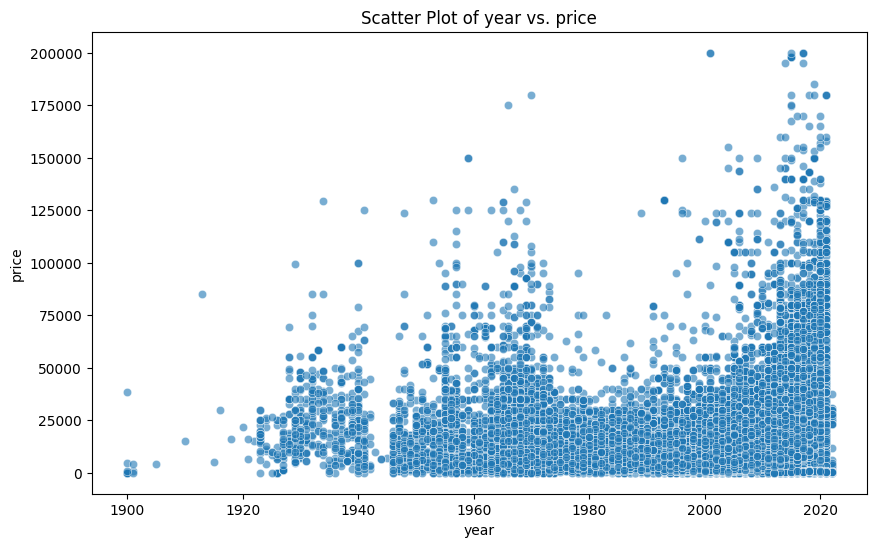

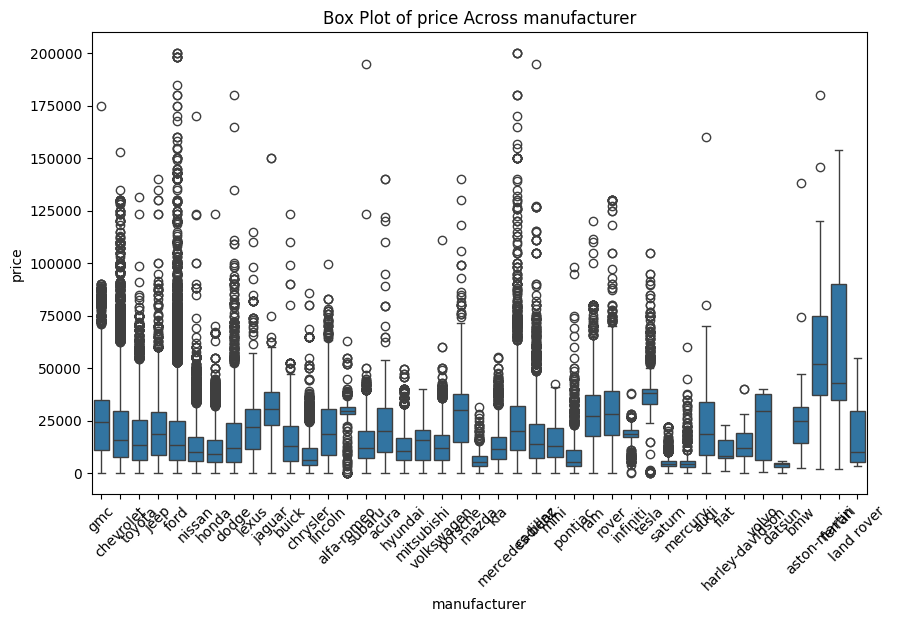

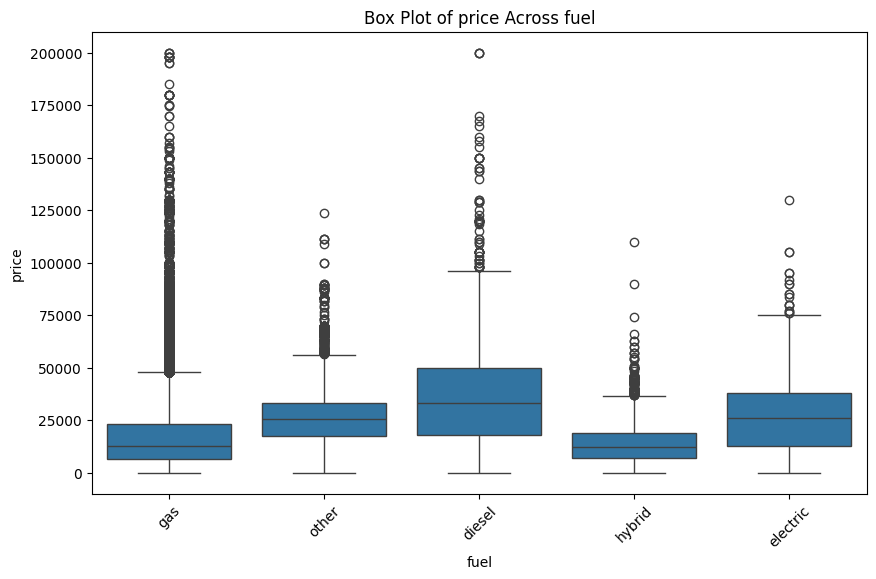

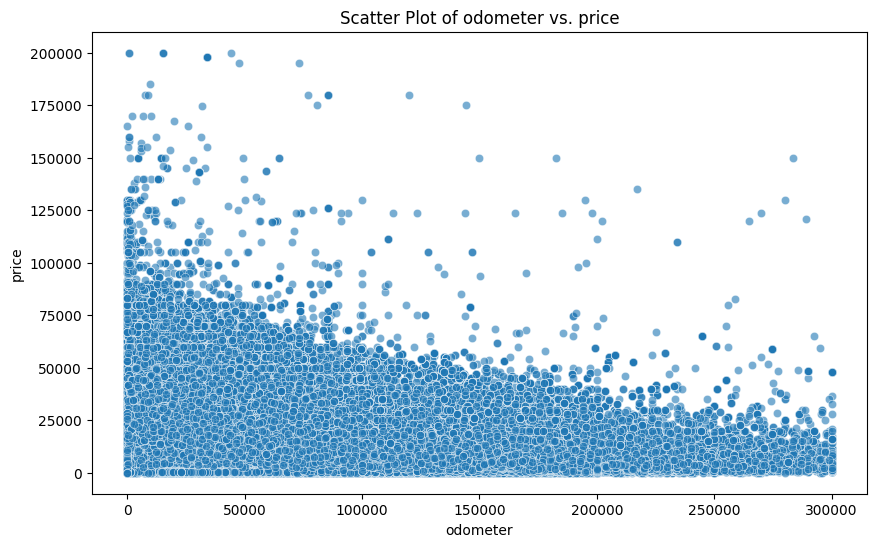

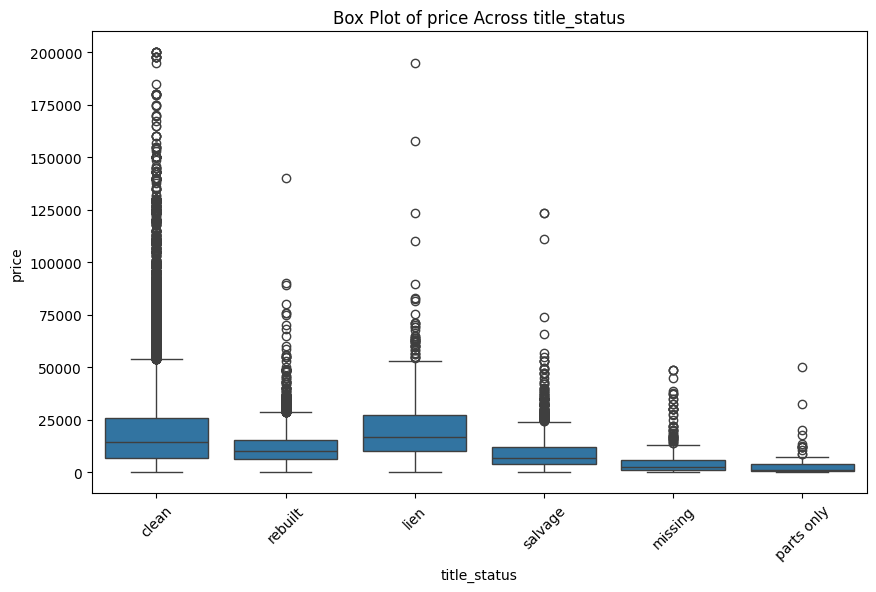

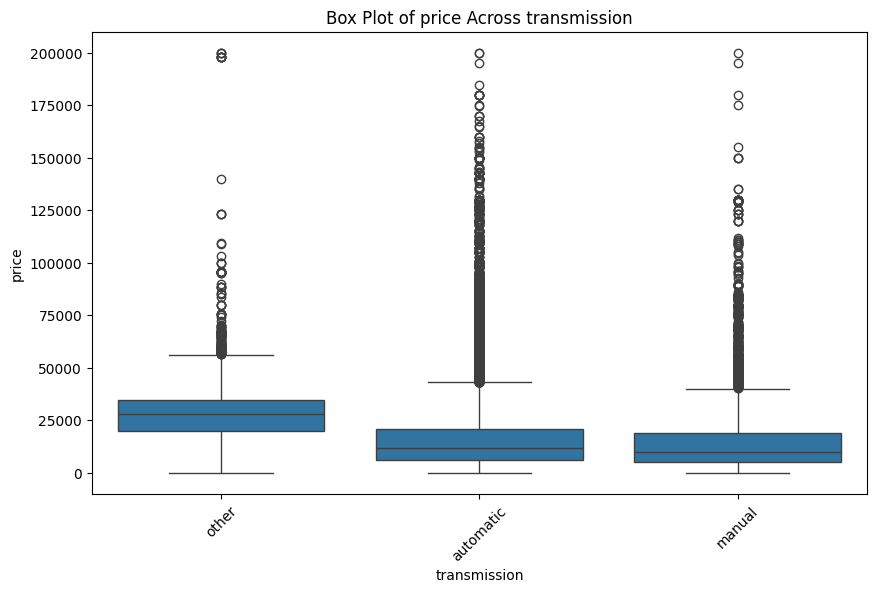

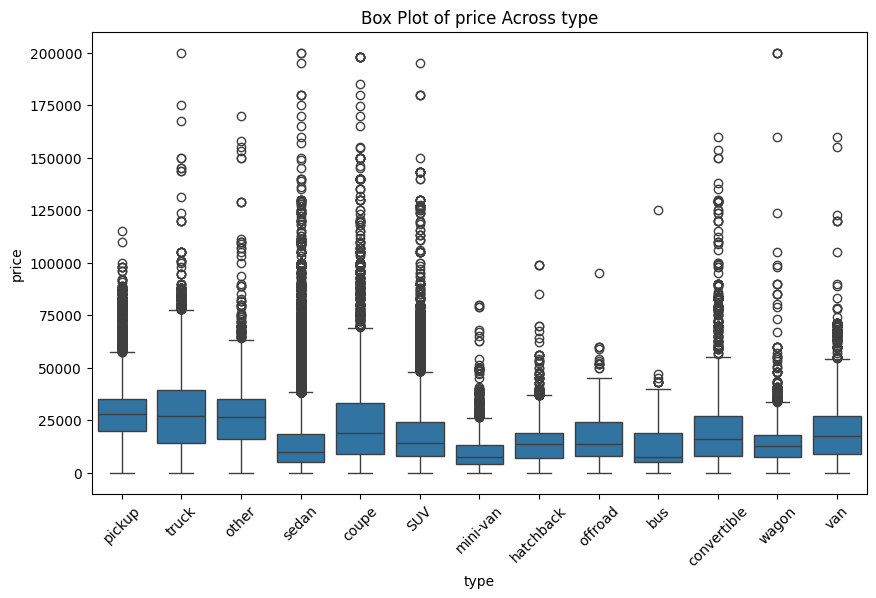

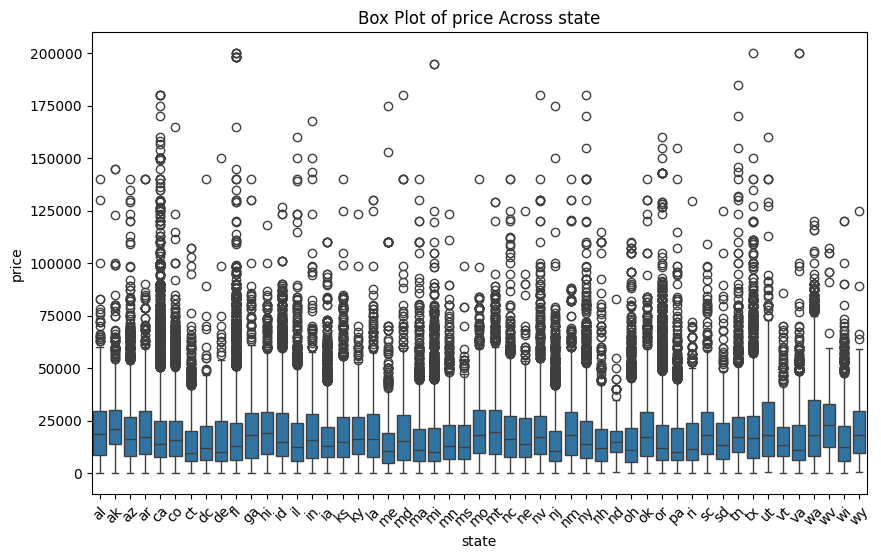

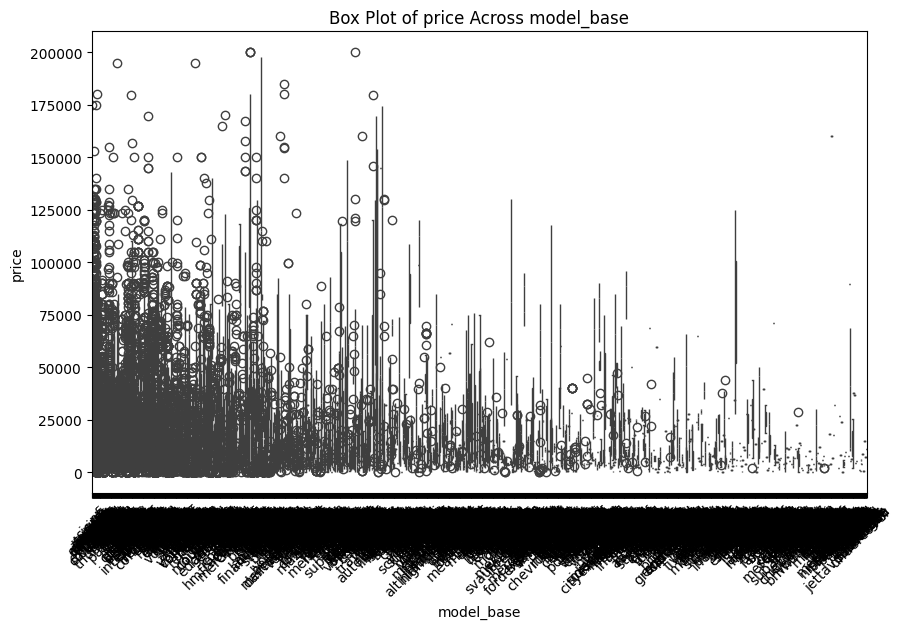

In [8]:
features_to_plot = df.columns
target_variable = 'price'

for feature in features_to_plot:
    if df[feature].dtype == 'object' or len(df[feature].unique()) < 10:  # Categorical data
        plt.figure(figsize=(10, 6))
        sns.boxplot(data=df, x=feature, y=target_variable)
        plt.title(f'Box Plot of {target_variable} Across {feature}')
        plt.xticks(rotation=45)
    else:  # Numerical data
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=df, x=feature, y=target_variable, alpha=0.6)
        plt.title(f'Scatter Plot of {feature} vs. {target_variable}')
    plt.xlabel(feature)
    plt.ylabel(target_variable)
    plt.show()

1. Odometer: The scatter plot suggests a decrease in price as mileage increases, possibly at a decreasing rate, indicating potential for polynomial feature transformation.
2. Year: Newer cars have an increasing price but not at a constant rate, which may be better captured with a polynomial term.

3. Model Base: Given the high variability and many unique models, this feature may require more complex transformations or feature engineering.


## Feature Selection (SFS)

In [8]:
all_indices = list(range(len(df)))  # Convert range to list
random.shuffle(all_indices)  # Shuffle the list of indices

# Split the shuffled indices into training and development sets
training_indices, dev_indices = np.split(all_indices, [233539])

In [14]:
polynomial_features_cols = X_train.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = X_train.select_dtypes(include=['object', 'bool']).columns

# Preprocessing for numerical data that needs polynomial features
poly_numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),  # Impute missing values
    ('poly', PolynomialFeatures(degree=10, include_bias=False)),  # Generate polynomial features
    ('scaler', StandardScaler()),  # Then scale the data
])

# Preprocessing for categorical data: one-hot encoding
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

# Create the column transformer
preprocessor = ColumnTransformer(
    transformers=[
        ('poly_num', poly_numerical_transformer, polynomial_features_cols),
        ('cat', categorical_transformer, categorical_cols),
    ])

pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('feature_select', SequentialFeatureSelector(
        LinearRegression(),
        scoring='neg_mean_squared_error',
        n_features_to_select=10,
        cv=[[training_indices, dev_indices]]
    ))
])

pipeline.fit(X, y)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('poly_num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('poly',
                                                                   PolynomialFeatures(degree=10,
                                                                                      include_bias=False)),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  Index(['year', 'odometer', 'customer_cluster'], dtype='object')),
                                                 ('cat',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  Index(['manufacturer', 'fuel', 'title_status', 'transmission', 'type', 'state',
       'model_base'],
      dtype='object'))])),
                ('feature_select',
                 SequentialFeatureSelector(cv=[[array([ 74085, 255233, 231187, ...,  96030, 269938, 179695]),
                                                array([132427, 247366,   1250, ..., 163451, 285651, 137460])]],
                                           estimator=LinearRegression(),
                                           n_features_to_select=10,
                                           scoring='neg_mean_squared_error'))])

degree 10:

In [15]:
feature_selector_degree10 = pipeline.named_steps['feature_select']

# Get the mask of selected features
selected_mask_degree10 = feature_selector_degree10.get_support()

# Retrieve the feature names transformed by the preprocessor step
transformed_feature_names_degree10 = preprocessor.get_feature_names_out()

# Map the selected features to their original names
selected_features_LR_degree10 = transformed_feature_names_degree10[selected_mask_degree10]

print(f"Selected features: {selected_features_LR_degree10}")

Selected features: ['poly_num__odometer' 'poly_num__year^6 customer_cluster^4'
 'cat__fuel_diesel' 'cat__transmission_other' 'cat__type_pickup'
 'cat__type_truck' 'cat__model_base_corvette' 'cat__model_base_gclass'
 'cat__model_base_lamborghini' 'cat__model_base_mclaren']


degree 5:

In [12]:
feature_selector = pipeline.named_steps['feature_select']

# Get the mask of selected features
selected_mask = feature_selector.get_support()

# Retrieve the feature names transformed by the preprocessor step
transformed_feature_names = preprocessor.get_feature_names_out()

# Map the selected features to their original names
selected_features_LR = transformed_feature_names[selected_mask]

print(f"Selected features: {selected_features_LR}")

Selected features: ['poly_num__odometer' 'poly_num__customer_cluster^4'
 'poly_num__year customer_cluster^4' 'cat__fuel_diesel'
 'cat__transmission_other' 'cat__type_pickup' 'cat__type_truck'
 'cat__model_base_corvette' 'cat__model_base_lamborghini'
 'cat__model_base_mclaren']


Introduces a higher degree interaction ('poly_num__year^6 customer_cluster^4') and features another luxury brand ('cat__model_base_gclass'), indicating the potential nonlinear impact of vehicle age and customer cluster, as well as the significance of luxury brands.

There seems to be overlap of feature that model 5 and 10 degree explain but with 10, it suggest slightly something different with the non-linearity feature for more luxury car.

So let's go with degree ten

## Model Optimization - GridSearchCv

In [16]:
X_train_transformed = preprocessor.transform(X_train)
X_test_transformed = preprocessor.transform(X_test)

# Extract only the columns for selected features
# Let's say selected_mask is a boolean array indicating the selected features
X_train_selected = X_train_transformed[:, selected_mask]
X_test_selected = X_test_transformed[:, selected_mask]

let's find the optimal alpha for Lasso and Ridge modelling later

In [17]:
from sklearn.linear_model import LassoCV, RidgeCV

# LassoCV and RidgeCV can automatically select the best alpha through cross-validation
lasso_cv = LassoCV(cv=5, random_state=42).fit(X_train_selected, y_train)
ridge_cv = RidgeCV(cv=5).fit(X_train_selected, y_train)

# Retrieve the optimal alpha values found
optimal_alpha_lasso = lasso_cv.alpha_
optimal_alpha_ridge = ridge_cv.alpha_

print(f"Optimal alpha for Lasso: {optimal_alpha_lasso}")
print(f"Optimal alpha for Ridge: {optimal_alpha_ridge}")

# Evaluate the models on the test set
lasso_cv_test_score = lasso_cv.score(X_test_selected, y_test)
ridge_cv_test_score = ridge_cv.score(X_test_selected, y_test)

print(f"Lasso CV Test Score: {lasso_cv_test_score}")
print(f"Ridge CV Test Score: {ridge_cv_test_score}")


Optimal alpha for Lasso: 10.769990218955366
Optimal alpha for Ridge: 0.1
Lasso CV Test Score: 0.5689384370975161
Ridge CV Test Score: 0.5710573850703009


The Lasso R² Score is 0.5689384370975161 versus 0.5710573850703009 scored by Ridge

The best model we found for Ridge and Lasso is alpha 0.1 and 10.769990218955366 vice versa.

Again, the R^2 represents the proportion of variance for the dependent variable that's explained by the independent variables in a regression model. Which means that 

## Coefficent Analysis

In [21]:
# Lasso Coefficients
lasso_coeffs = dict(zip(selected_features_LR_degree10, lasso_cv.coef_))
print("Lasso Coefficients:", lasso_coeffs)

# Ridge Coefficients
ridge_coeffs = dict(zip(selected_features_LR_degree10, ridge_cv.coef_))
print("Ridge Coefficients:", ridge_coeffs)

Lasso Coefficients: {'poly_num__odometer': -2091.21142856411, 'poly_num__year^6 customer_cluster^4': -0.0, 'cat__fuel_diesel': -0.0, 'cat__transmission_other': 3410.4533515906783, 'cat__type_pickup': -2181.7568158742683, 'cat__type_truck': 9163.606348653875, 'cat__model_base_corvette': 0.0, 'cat__model_base_gclass': 0.0, 'cat__model_base_lamborghini': 0.0, 'cat__model_base_mclaren': 0.0}
Ridge Coefficients: {'poly_num__odometer': -14620.112170689208, 'poly_num__year^6 customer_cluster^4': -6175.640852018203, 'cat__fuel_diesel': -3373.447165914997, 'cat__transmission_other': 6547.960007198586, 'cat__type_pickup': -5234.592062361506, 'cat__type_truck': 18457.47455016705, 'cat__model_base_corvette': 11471.994213622023, 'cat__model_base_gclass': 11.315060013978478, 'cat__model_base_lamborghini': 70.07950660924914, 'cat__model_base_mclaren': 17.031966043103704}


let's put into a dataframe for easier to look at:

In [22]:
# Given the context provided, let's create a DataFrame from the lasso and ridge coefficients.

# Creating a DataFrame for Lasso coefficients
lasso_df = pd.DataFrame.from_dict(lasso_coeffs, orient='index', columns=['Lasso Coefficients'])

# Creating a DataFrame for Ridge coefficients
ridge_df = pd.DataFrame.from_dict(ridge_coeffs, orient='index', columns=['Ridge Coefficients'])

# Combining the two into a single DataFrame
coefficients_df = pd.concat([lasso_df, ridge_df], axis=1)
coefficients_df.reset_index(inplace=True)
coefficients_df.rename(columns={'index': 'Features'}, inplace=True)

coefficients_df



,Features,Lasso Coefficients,Ridge Coefficients
0,poly_num__odometer,-2091.211429,-14620.112171
1,poly_num__year^6 customer_cluster^4,-0.000000,-6175.640852
2,cat__fuel_diesel,-0.000000,-3373.447166
3,cat__transmission_other,3410.453352,6547.960007
4,cat__type_pickup,-2181.756816,-5234.592062
5,cat__type_truck,9163.606349,18457.474550
6,cat__model_base_corvette,0.000000,11471.994214
7,cat__model_base_gclass,0.000000,11.315060
8,cat__model_base_lamborghini,0.000000,70.079507
9,cat__model_base_mclaren,0.000000,17.031966


### Insights from Lasso and Ridge Coefficients

1. **Odometer Reading (`poly_num__odometer`)**:
   - **Lasso Coefficient**: -2091.211429
   - **Ridge Coefficient**: -14620.112171
   - **Insight**: Both models agree that higher odometer readings (indicating higher mileage) negatively impact the car's price. The impact is more pronounced in the Ridge model.
   - **Strategy**: Prioritize acquiring and promoting vehicles with lower mileage, as they're likely to command higher prices.

2. **Transmission Type (`cat__transmission_other`)**:
   - **Lasso Coefficient**: 3410.453352
   - **Ridge Coefficient**: 6547.960007
   - **Insight**: Vehicles with "other" transmission types are positively correlated with price, suggesting they might offer unique selling points or cater to specific market niches.
   - **Strategy**: Consider stocking a diverse range of vehicles that include models with non-standard transmissions to appeal to niche markets.

3. **Vehicle Types (`cat__type_pickup`, `cat__type_truck`)**:
   - **Pickup**: Both models indicate that pickups tend to be valued lower, except the effect is negative in the Lasso model.
   - **Truck**: Contrary to pickups, trucks show a strong positive relationship with price, especially prominent in the Ridge model.
   - **Insight**: Trucks are highly valued in the market, potentially due to their utility, durability, or specific consumer demand.
   - **Strategy**: Increase inventory of trucks, potentially focusing on newer, lower-mileage options to maximize their appeal and pricing.

4. **Luxury and High-Performance Models**:
   - **Selected Models**: Corvette, G-Class, Lamborghini, McLaren.
   - **Insight**: The presence of these models in the Ridge model (with positive coefficients) highlights the premium market places on luxury and high-performance vehicles. Lasso zeroes out these coefficients, likely due to its regularization penalty favoring a simpler model.
   - **Strategy**: Actively seek out and promote luxury and high-performance models, leveraging their brand value and performance as key selling points.

5. **Diesel Fuel Type (`cat__fuel_diesel`)**:
   - **Insight**: The negative coefficient in Ridge (not selected in Lasso) suggests that, all else being equal, diesel vehicles might be less favored or command lower prices than their counterparts.
   - **Strategy**: Evaluate the inventory mix of diesel vehicles, considering market demand and preferences. It might be beneficial to balance diesel vehicles with others that are more favored in your market.

### Further Analysis

- **Market Segmentation**: Dive deeper into customer preferences within different segments. The model indicates a nuanced market with specific preferences for transmission types, vehicle types, and luxury brands.
- **Dynamic Pricing**: Use these insights to adjust pricing dynamically, considering factors like mileage, vehicle type, and luxury brand status.
- **Promotional Strategies**: Develop marketing campaigns that highlight the unique features of trucks and luxury models, emphasizing their value propositions.

### Conclusion

The coefficients from Lasso and Ridge models offer a roadmap for adjusting dealership inventory and marketing strategies to align with consumer preferences and market demand. By focusing on vehicles with characteristics positively associated with higher prices—such as lower mileage, trucks, and certain luxury brands—the dealership can enhance its inventory's appeal and potentially increase profitability.

# Learning Curve Analysis

Out of curiosity, I want to check the performance of selected features + optimal alpha because even when using models configured with the optimal alpha values identified through cross-validation, it's still possible for those models to exhibit overfitting or underfitting. 

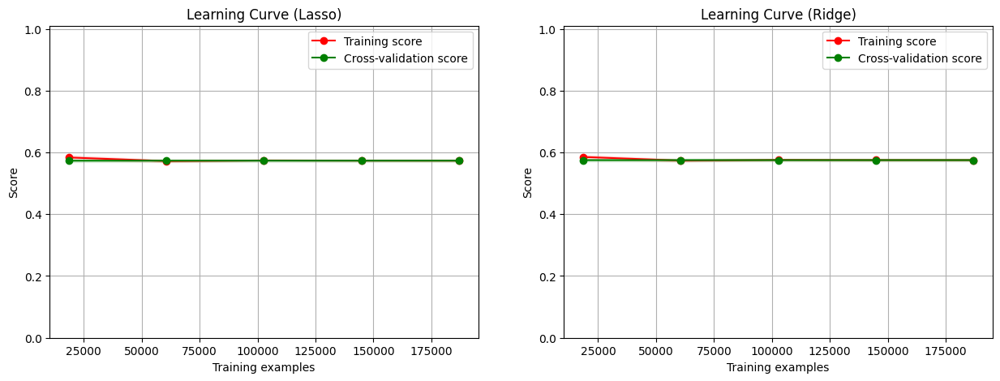

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate a simple plot of the test and training learning curve.

    Parameters
    ----------
    estimator : object type that implements the "fit" and "predict" methods
    title : string
        Title for the chart.
    X : array-like, shape (n_samples, n_features)
        Training vector, where n_samples is the number of samples and
        n_features is the number of features.
    y : array-like, shape (n_samples) or (n_samples, n_features), optional
        Target relative to X for classification or regression;
        None for unsupervised learning.
    axes : axes object, optional (default=None)
        Axes used to plot the curves.
    ylim : tuple, shape (ymin, ymax), optional
        Defines minimum and maximum yvalues plotted.
    cv : int, cross-validation generator or an iterable, optional
        Determines the cross-validation splitting strategy.
    n_jobs : int or None, optional (default=None)
        Number of jobs to run in parallel.
    train_sizes : array-like, shape (n_ticks,), dtype float or int
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve.
    """
    if axes is None:
        _, axes = plt.subplots(1, 1, figsize=(20, 5))

    axes.set_title(title)
    if ylim is not None:
        axes.set_ylim(*ylim)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes,
        scoring="r2")
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    # Plot learning curve
    axes.grid()
    axes.fill_between(train_sizes, train_scores_mean - train_scores_std,
                      train_scores_mean + train_scores_std, color="r", alpha=0.1)
    axes.fill_between(train_sizes, test_scores_mean - test_scores_std,
                      test_scores_mean + test_scores_std, color="g", alpha=0.1)
    axes.plot(train_sizes, train_scores_mean, 'o-', color="r",
              label="Training score")
    axes.plot(train_sizes, test_scores_mean, 'o-', color="g",
              label="Cross-validation score")
    axes.legend(loc="best")

    return plt

fig, axes = plt.subplots(1, 2, figsize=(15, 5))

plot_learning_curve(lasso_cv, "Learning Curve (Lasso)", X_train_selected, y_train, axes=axes[0], ylim=(0.0, 1.01), cv=5, n_jobs=4)
plot_learning_curve(ridge_cv, "Learning Curve (Ridge)", X_train_selected, y_train, axes=axes[1], ylim=(0.0, 1.01), cv=5, n_jobs=4)

plt.show()


# What's Next

Linear and multiple regression, along with feature selection techniques (Sequential Feature Selection (SFS)/Recursive Feature Elimination (RFE)) and regularization methods (Lasso (L1) and Ridge (L2)), offer a robust toolkit for understanding and predicting outcomes based on a set of input features. While K-means clustering and PCA are powerful for segmenting groups and reducing dimensionality, respectively, the aforementioned tools can provide deeper insights into the relationships between features and the target variable, enhance predictive accuracy, and prevent overfitting. Here’s how they can bring additional insights and utility:

### Understanding Relationships and Predicting Outcomes

- **Linear and Multiple Regression**: These models can quantify the relationship between each feature (e.g., car attributes like make, year, model) and the target variable (e.g., price or demand), allowing you to make predictions. For example, they can help determine how much the price increases for each additional year newer a car is, holding other factors constant.

- **Feature Selection (SFS/RFE)**: By identifying which features are most predictive of the target variable, these techniques can help focus on the most important variables, simplifying the model without sacrificing predictive power. This can inform inventory decisions by highlighting which car attributes most strongly influence price or demand.

### Enhancing Predictive Accuracy and Preventing Overfitting

- **Regularization (Lasso and Ridge)**: These methods add a penalty to the model for having too many or too large coefficients, which helps to prevent overfitting to the training data. This can improve the model’s generalizability to unseen data, making your predictions more reliable.

  - **Lasso (L1 regularization)** not only helps in preventing overfitting but also performs feature selection by shrinking some coefficients to zero. This can further refine your understanding of which features are truly important for predicting the target variable.
  
  - **Ridge (L2 regularization)** is particularly useful when dealing with multicollinearity or when you have many correlated features, as it helps to distribute the weight among them.

### Applying ML Tools for Deeper Insights Beyond K-means and PCA

1. **Predictive Modeling for Inventory Pricing and Demand**: Beyond segmenting the market (as done with K-means), linear regression models can predict specific outcomes like car prices or demand levels based on detailed attributes. This allows for more precise inventory pricing and stocking strategies.

2. **Identifying Key Features for Market Competitiveness**: Feature selection techniques can pinpoint the car attributes most associated with higher prices or demand, enabling dealerships to prioritize these in their inventory.

3. **Robust Modeling in the Presence of High Dimensionality**: Regularization techniques ensure that models remain generalizable and predictive even when dealing with a large number of features (e.g., after one-hot encoding of categorical variables), a situation where overfitting is a risk.

4. **Data-Driven Inventory Optimization**: By combining the predictive power of regression models with the insights from clustering (e.g., customer segments), dealerships can tailor their inventory not only to the general market demand but also to the preferences of specific customer segments identified through clustering.

In summary, while K-means clustering and PCA provide foundational insights through segmentation and dimensionality reduction, linear regression, regularization, and feature selection techniques build on these by offering precise, predictive models that can guide strategic decisions around pricing, inventory selection, and marketing to different customer segments. These tools enable a data-driven approach to inventory management that is both responsive to market demands and aligned with the dealership’s strategic goals.

    Model Evaluation: Use cross-validation to evaluate different models (Linear Regression, Ridge, Lasso) using only the selected features. The model with the best cross-validation score (e.g., lowest RMSE) is considered the best performer.

    Hyperparameter Tuning: For Ridge and Lasso, you may also need to fine-tune the regularization strength (alpha). This can be done using grid search with cross-validation (GridSearchCV) or specialized CV estimators like RidgeCV and LassoCV.

    Final Model Selection: Choose the model and hyperparameters that provide the best balance of prediction accuracy and generalization as indicated by your cross-validation metrics.